In [28]:
import plotly.graph_objects as go
import plotly.io as pio
from tqdm.notebook import tqdm
import plotly.express as px
import pandas as pd
import geopandas as gp
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import math
import json

In [29]:
def make_graph_from_df(df):
    G = nx.from_pandas_edgelist(
        df, 
        source="pickup_loc_id",
        target="dropoff_loc_id",
        edge_attr=True,
        create_using=nx.DiGraph
    )
    return G

In [30]:
def add_coords_to_nodes(G, df_geo):
    for node in G.nodes:
        try:
            G.nodes[node]['pos'] = list(df_geo[df_geo["objectid"] == node].centroid.iloc[0].coords)[0]
            G.nodes[node]['zone'] = df_geo[df_geo["objectid"] == node].zone.iloc[0]
        except:
            G.nodes[node]['pos'] = list(df_geo[df_geo["objectid"] == 1].centroid.iloc[0].coords)[0]
            G.nodes[node]['zone'] = df_geo[df_geo["objectid"] == 1].zone.iloc[0]

In [31]:
def scale_to(array, new_min, new_max, log = False):
    if log:
        old_min = np.log(min(array))
        old_max = np.log(max(array))
        return [((new_max - new_min) * (np.log(x) - old_min)) / (old_max - old_min) + new_min for x in array] 
    else:
        old_min = min(array)
        old_max = max(array)
        return [((new_max - new_min) * (x - old_min)) / (old_max - old_min) + new_min for x in array]

In [32]:
def draw_graph(G,df_geo, colors, widths, edge_cmap=plt.cm.spring, alpha=1, arrowsize = 1, font_size=12, filename="basic.png", geo_column = "objectid", geo_cmap='Blues'):
    plt.figure(1,figsize=(60,60)) 
    plt.axis('off')

    #nx.draw_networkx_nodes(G, nx.get_node_attributes(G, "pos"), node_size=100, node_color="red")
    nx.draw_networkx_edges(G, nx.get_node_attributes(G, "pos"), edge_cmap=edge_cmap, alpha=alpha, edge_color=colors, width=widths, edge_vmin=0, arrowsize=arrowsize)
    nx.draw_networkx_labels(G, nx.get_node_attributes(G, "pos"), labels = nx.get_node_attributes(G, "zone"), font_size=font_size)
    ax = plt.gca()
    df_geo.plot(ax = ax, column = geo_column, cmap=geo_cmap)
    plt.savefig(filename)
    return None

In [33]:
df_geo = gp.read_file("data/NYC Taxi Zones/geo_export_38097766-152c-469f-95c0-313056068b21.shp")
df_edge_summary = pd.read_csv("summary.csv", sep = ";")

In [34]:
G = make_graph_from_df(df_edge_summary)
add_coords_to_nodes(G, df_geo)

In [35]:
colors = scale_to([G[a][b]["count"] for a, b in G.edges()], 0, 1, log=True)
widths = scale_to([G[a][b]["count"] for a, b in G.edges()], 0.01, 100, log=False)

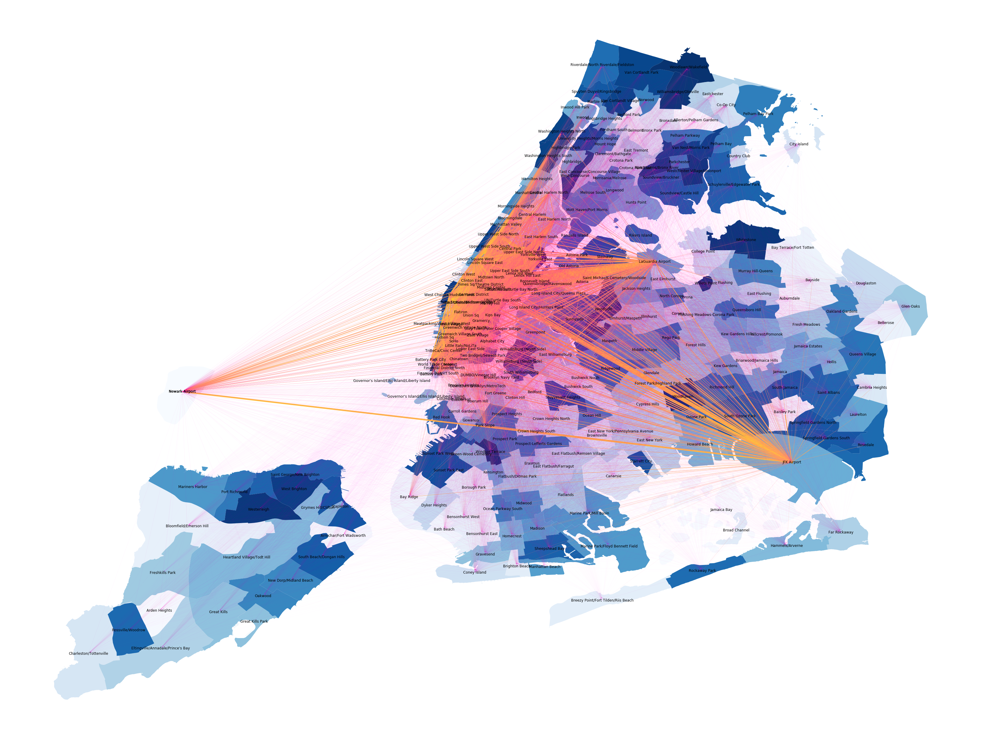

In [9]:
draw_graph(G, df_geo, colors=colors, widths=widths)

In [19]:
threshold_bot = 3000
threshold_top = 4000
top_n_df =  df_edge_summary.sort_values(by="count", ascending = False)[threshold_bot:threshold_top]
top_n_G = make_graph_from_df(top_n_df)
add_coords_to_nodes(top_n_G, df_geo)
top_n_colors = scale_to([top_n_G[a][b]["count"] for a, b in top_n_G.edges()], 0, 1, log=True)
top_n_widths = scale_to([top_n_G[a][b]["count"] for a, b in top_n_G.edges()], 0.01, 100, log=False)

bot_n_df =  df_edge_summary.sort_values(by="count", ascending = True)[threshold_bot:threshold_top]
bot_n_G = make_graph_from_df(bot_n_df)
add_coords_to_nodes(bot_n_G, df_geo)
bot_n_colors = [bot_n_G[a][b]["count"] for a, b in bot_n_G.edges()]
bot_n_widths = [bot_n_G[a][b]["count"] for a, b in bot_n_G.edges()]

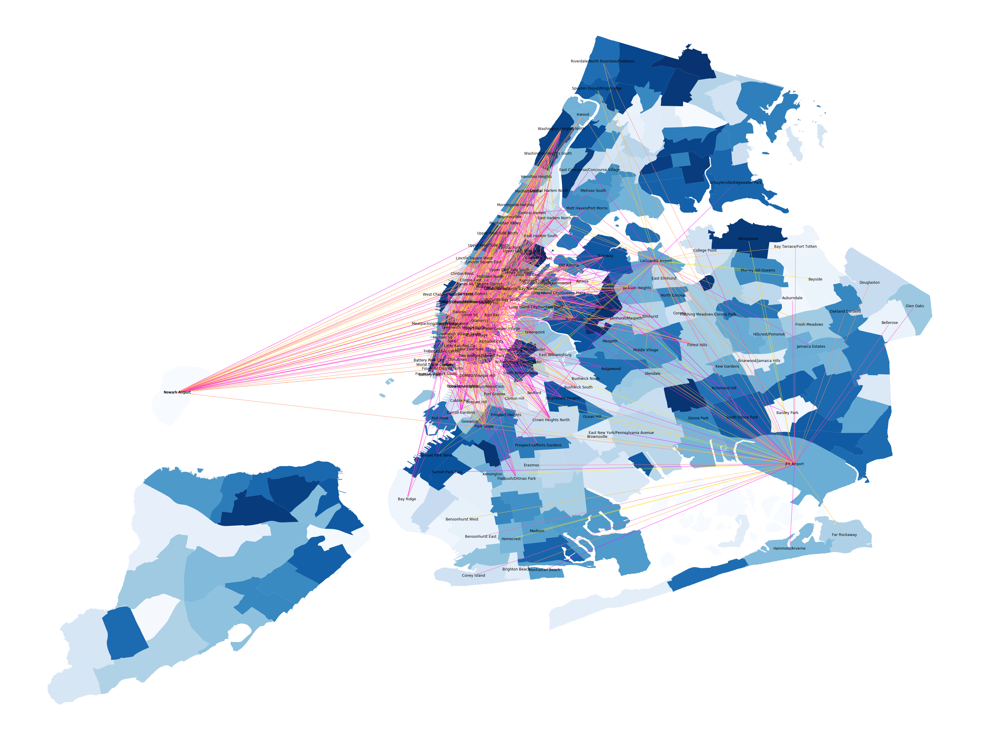

In [20]:
draw_graph(top_n_G, df_geo, colors=top_n_colors, widths=1)

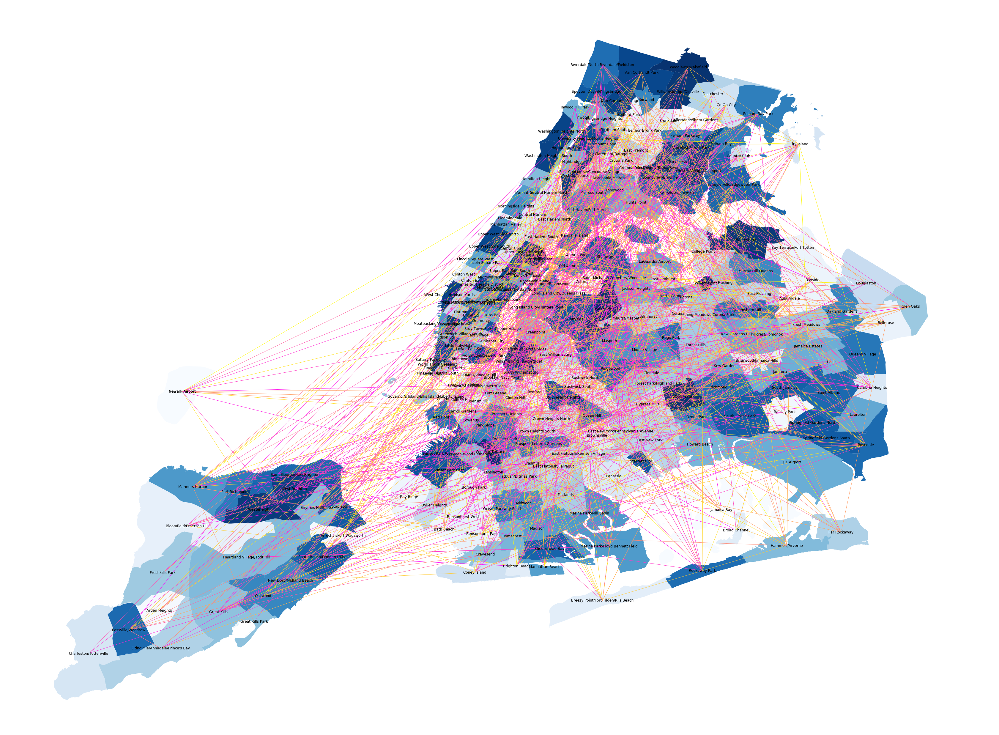

In [18]:
draw_graph(bot_n_G, df_geo, colors=top_n_colors, widths=1)

In [10]:
df_edge_summary[df_edge_summary["count"] == 1]["pickup_loc_id"].value_counts()

206    59
120    56
46     51
253    49
73     49
       ..
170     1
161     1
229     1
163     1
104     1
Name: pickup_loc_id, Length: 256, dtype: int64

In [85]:
pickup_loc_counts = df_edge_summary.groupby(by = "pickup_loc_id").sum()["count"]
dropoff_loc_counts = df_edge_summary.groupby(by = "dropoff_loc_id").sum()["count"]

In [86]:
df_geo_pickup_counts = df_geo.merge(pickup_loc_counts, left_on = "objectid", right_on = "pickup_loc_id")
df_geo_dropoff_counts = df_geo.merge(dropoff_loc_counts,  left_on = "objectid", right_on = "dropoff_loc_id")

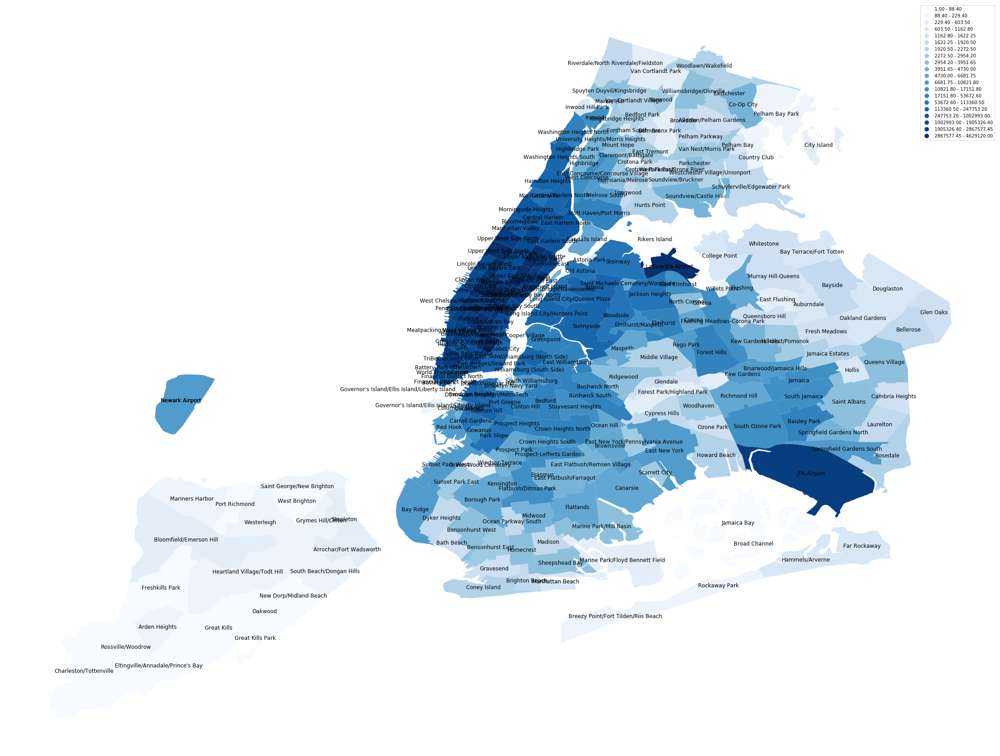

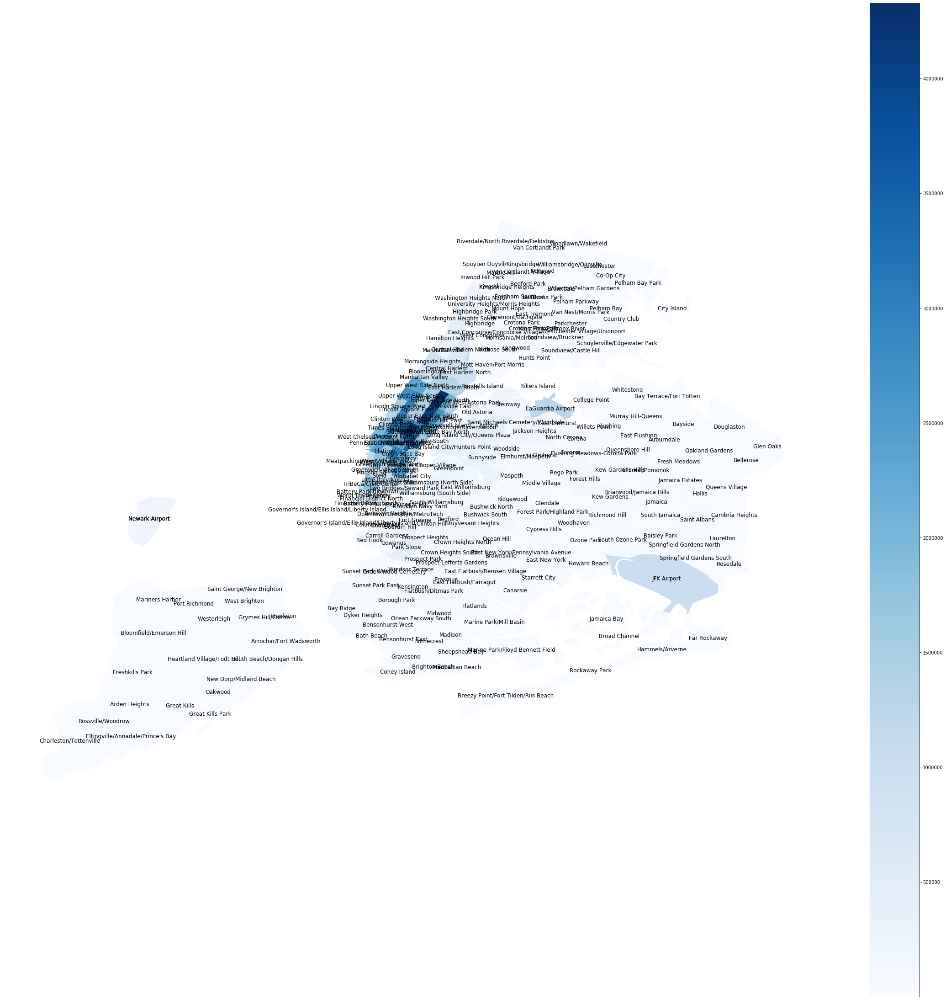

In [95]:
plt.figure(1,figsize=(40,40)) 
plt.axis('off')
nx.draw_networkx_labels(G, nx.get_node_attributes(G, "pos"), labels = nx.get_node_attributes(G, "zone"), font_size=12)
ax = plt.gca()
df_geo_pickup_counts.plot(ax = ax, column = "count", cmap = "Blues", legend = True, scheme = "Quantiles", k = 20)
plt.show()

plt.figure(2,figsize=(40,40)) 
plt.axis('off')
nx.draw_networkx_labels(G, nx.get_node_attributes(G, "pos"), labels = nx.get_node_attributes(G, "zone"), font_size=12)
ax = plt.gca()
df_geo_dropoff_counts.plot(ax = ax, column = "count", cmap = "Blues", legend = True)
plt.show()

In [50]:
df_geo_dropoff_counts[df_geo_dropoff_counts.isnull().any(axis=1)]

,borough,location_i,objectid,shape_area,shape_leng,zone,geometry,count
103,Manhattan,103.0,103.0,0.000006,0.014306,Governor's Island/Ellis Island/Liberty Island,"POLYGON ((-74.04389 40.69018, -74.04351 40.689...",NaN


In [55]:
np.log(pickup_loc_counts)

pickup_loc_id
1       9.047939
2       4.369448
3       7.187657
4      12.365663
5       4.905275
         ...    
261    13.386339
262    14.086366
263    14.549069
264    14.385986
265    10.893809
Name: count, Length: 264, dtype: float64